For a proof of concept let's try and join some audio together and see what diarization pipeline will produce. I put some sample Iriss data `in audio`, let's read them and concatenate them together:

In [1]:
import pydub
from pathlib import Path

audio_files = list(Path("audio").glob("*wav"))
print("Available audio files: ", audio_files)



Available audio files:  [PosixPath('audio/Iriss-N-G5035-P600034-avd.wav'), PosixPath('audio/Iriss-N-G5036-P600034-avd.wav'), PosixPath('audio/Iriss-J-Gvecg-P500016-avd.wav')]


Let's try and read one of them:

In [2]:
random_audio_segment = pydub.AudioSegment.from_file(audio_files[0])
random_audio_segment

Let's read all of them:

In [3]:
audio_segments = [pydub.AudioSegment.from_file(i) for i in audio_files]

We can concatenate them using `+`, or `sum()`

In [4]:

concatenated_audio = sum(audio_segments)

In [5]:
concatenated_audio

Now let's save this and proceed with diarization. I found that some system library starts complaining, but the diarization works nonetheless (it's raising `[src/libmpg123/layer3.c:INT123_do_layer3():1771] error: part2_3_length (800) too large for available bit count (760)`).

Since only I have the file `../ASR_pipeline/secrets.json`, the code won't work for you yet. Run 
```python
from pyannote.audio import Pipeline
Pipeline.from_pretrained("pyannote/speaker-diarization-3.1")
```
which will throw an error. Follow the link in the error message to request access to the model on HuggingFace model hub (not difficult) and store the access token in `secrets.json` like this:
```
{
    "hf_token": "blablabla"
}
```

The code below is intended for GPU use, if you run it on CPU, change `cuda` to `cpu`. Try it with only one or two files first, though, to get a better sense of time needed. 



[src/libmpg123/layer3.c:INT123_do_layer3():1771] error: part2_3_length (1024) too large for available bit count (760)
[src/libmpg123/layer3.c:INT123_do_layer3():1771] error: part2_3_length (800) too large for available bit count (760)
[src/libmpg123/layer3.c:INT123_do_layer3():1771] error: part2_3_length (800) too large for available bit count (760)
[src/libmpg123/layer3.c:INT123_do_layer3():1771] error: part2_3_length (800) too large for available bit count (760)
[src/libmpg123/layer3.c:INT123_do_layer3():1771] error: part2_3_length (896) too large for available bit count (760)
[src/libmpg123/layer3.c:INT123_do_layer3():1771] error: part2_3_length (928) too large for available bit count (760)
[src/libmpg123/layer3.c:INT123_do_layer3():1771] error: part2_3_length (800) too large for available bit count (760)
[src/libmpg123/layer3.c:INT123_do_layer3():1771] error: part2_3_length (864) too large for available bit count (760)
[src/libmpg123/layer3.c:INT123_do_layer3():1771] error: part2_3

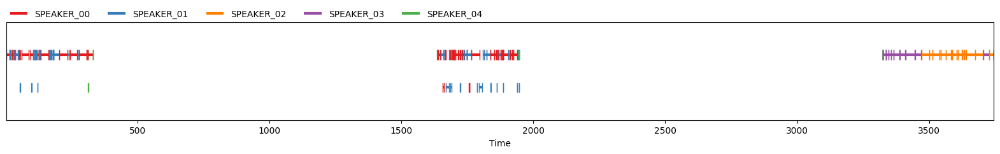

In [6]:
concatenated_audio.export("concatenated.wav")

import json
import os
from pathlib import Path
import torch
from pyannote.audio import Pipeline
os.environ["CUDA_VISIBLE_DEVICES"] = "6"
with open("../ASR_pipeline/secrets.json") as f:
    secrets = json.load(f)

# Load the pipeline:
pipeline = Pipeline.from_pretrained(
    "pyannote/speaker-diarization-3.1", 
    use_auth_token=secrets["hf_token"]
).to(torch.device("cuda"))

diarization = pipeline(
    "concatenated.wav",
    #  min_speakers=2, max_speakers=4
    )
diarization

Let's save the results as RTTM:

In [7]:
text_to_write = diarization.to_rttm()

Path("diarization.rttm").write_text(text_to_write)

9708

In [8]:
!head diarization.rttm

SPEAKER concatenated 1 1.893 11.392 <NA> <NA> SPEAKER_00 <NA> <NA>
SPEAKER concatenated 1 14.440 3.022 <NA> <NA> SPEAKER_01 <NA> <NA>
SPEAKER concatenated 1 18.684 4.346 <NA> <NA> SPEAKER_01 <NA> <NA>
SPEAKER concatenated 1 23.336 4.160 <NA> <NA> SPEAKER_00 <NA> <NA>
SPEAKER concatenated 1 28.090 3.786 <NA> <NA> SPEAKER_01 <NA> <NA>
SPEAKER concatenated 1 33.285 2.513 <NA> <NA> SPEAKER_00 <NA> <NA>
SPEAKER concatenated 1 36.171 9.423 <NA> <NA> SPEAKER_01 <NA> <NA>
SPEAKER concatenated 1 46.868 2.716 <NA> <NA> SPEAKER_01 <NA> <NA>
SPEAKER concatenated 1 51.384 2.530 <NA> <NA> SPEAKER_00 <NA> <NA>
SPEAKER concatenated 1 53.574 1.121 <NA> <NA> SPEAKER_01 <NA> <NA>
